# Feature Based Panoramic Image Stitching

# Algorithm 1


In [3]:
!pip  install numpy
!pip  install matplotlib
!pip  install opencv-python
!pip  install scikit-image
!pip  install scikit-learn

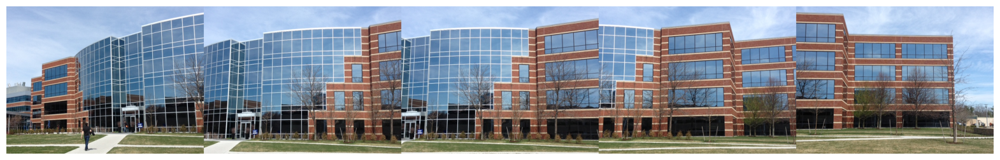

In [4]:
import cv2 as cv
import cv2
import numpy as np
import matplotlib.pyplot as plt

def cv2_imshow(image):
    cv2.imshow('Image', image)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

img1 = cv2.imread("building1/building1.jpg")
img2 = cv2.imread("building1/building2.jpg")
img3 = cv2.imread("building1/building3.jpg")
img4 = cv2.imread("building1/building4.jpg")
img5 = cv2.imread("building1/building5.jpg")
# Horizontal stitching of multiple images
concatenated_image = np.concatenate((img1, img2, img3, img4, img5), axis=1)
plt.figure(figsize=(20, 20))
plt.imshow(cv2.cvtColor(concatenated_image, cv2.COLOR_BGR2RGB))
plt.axis('off')  
plt.show()


# 1. Извлечение особых точек
Используем детектор ORB для извлечения ключевых точек.


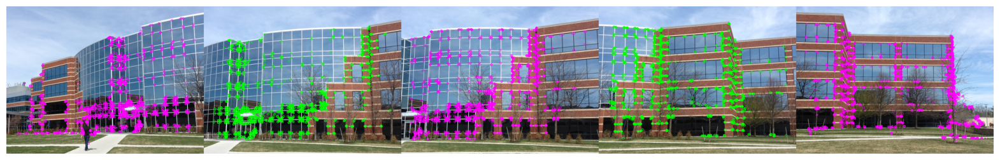

In [5]:
orb = cv.ORB_create(nfeatures=2000)

# Find the key points and descriptors with ORB
keypoints1, descriptors1 = orb.detectAndCompute(img1, None)
keypoints2, descriptors2 = orb.detectAndCompute(img2, None)
keypoints3, descriptors3 = orb.detectAndCompute(img3, None)
keypoints4, descriptors4 = orb.detectAndCompute(img4, None)
keypoints5, descriptors5 = orb.detectAndCompute(img5, None)

img1_kp = cv.drawKeypoints(img1, keypoints1, None, (255, 0, 255))
img2_kp = cv.drawKeypoints(img2, keypoints2, None, (0, 255, 0))
img3_kp = cv.drawKeypoints(img3, keypoints3, None, (255, 0, 255))
img4_kp = cv.drawKeypoints(img4, keypoints4, None, (0, 255, 0))
img5_kp = cv.drawKeypoints(img5, keypoints5, None, (255, 0, 255))
concatenated_kp_image = np.concatenate((img1_kp, img2_kp, img3_kp, img4_kp, img5_kp), axis=1)
plt.figure(figsize=(20, 20))
plt.imshow(cv.cvtColor(concatenated_kp_image, cv.COLOR_BGR2RGB))
plt.axis('off') 
plt.show()

In [6]:
# Print descriptors for the first keypoint of multiple images
for i, descriptors in enumerate([descriptors1, descriptors2, descriptors3, descriptors4, descriptors5]):
    if descriptors is not None and len(descriptors) > 0:
        print(f"Descriptor of the first keypoint for image {i + 1}:")
        print(descriptors[0])
    else:
        print(f"No descriptors for image {i + 1}")


Descriptor of the first keypoint for image 1:
[ 39 174 232  89 221 189 234 202  91  41 125  88 130 232 214 188  25 138
  18  24 150  58 238 242  15  29 145 125 211 205 218 132]
Descriptor of the first keypoint for image 2:
[113  93  22 108  57 143  86  56 193   8 170 108 102 242  36 215 192 245
 108  98 109  35  82  61 178 248  96  26  88  58  42   7]
Descriptor of the first keypoint for image 3:
[196 250 157  95 170  68  39 184 186 218  53 116 244 247 205 251 149 117
 236  66 225  68 235  51  37 163 103 174   0  51   7 113]
Descriptor of the first keypoint for image 4:
[  2 241 185 195 203  77 181 207  43 113  29  56 156 191  76  46 191  27
 211 145  83  88 250 209  79  17 221 239 199  66 135 243]
Descriptor of the first keypoint for image 5:
[182 206 134 150 147  98 156 230  59 151 234 147 108 110 108  91 237 219
 167 129  58 219  75 235 185  18 223   3 129 121 165   6]


# 2. Сопоставление особых точек
Вспомогательная функция для визуализации сопоставленных точек.
# 2. 匹配特殊点
可视化匹配点的辅助功能。

In [7]:
def draw_matches(img1, keypoints1, img2, keypoints2, matches):
  r1, c1 = img1.shape[:2]
  r2, c2 = img2.shape[:2]

  # Create a blank image with the size of the first image + second image
  output_img = np.zeros((max([r1, r2]), c1+c2, 3), dtype='uint8')
  output_img[:r1, :c1, :] = img1 #np.dstack([img1, img1, img1])
  output_img[:r2, c1:c1+c2, :] = img2 #np.dstack([img2, img2, img2])

  for match in matches:
    img1_idx = match.queryIdx
    img2_idx = match.trainIdx
    (x1, y1) = keypoints1[img1_idx].pt
    (x2, y2) = keypoints2[img2_idx].pt

    # Draw circles on the keypoints
    cv.circle(output_img, (int(x1),int(y1)), 4, (0, 255, 255), 1)
    cv.circle(output_img, (int(x2)+c1,int(y2)), 4, (0, 255, 255), 1)

    # Connect the same keypoints
    cv.line(output_img, (int(x1),int(y1)), (int(x2)+c1,int(y2)), (0, 255, 255), 1)

  return output_img

  

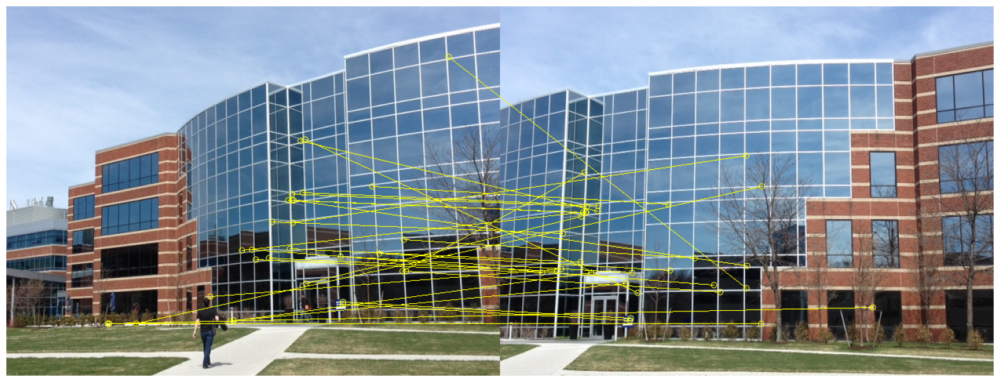

In [8]:
# Create a BFMatcher object.
# It will find all of the matching keypoints on two images
bf = cv.BFMatcher_create(cv.NORM_HAMMING)

# Find matching points
matches = bf.knnMatch(descriptors1, descriptors2, k=2)

all_matches = []
for m, n in matches:
  all_matches.append(m)

img3 = draw_matches(img1, keypoints1, img2, keypoints2, all_matches[:30])
plt.figure(figsize=(20, 20))
plt.imshow(cv.cvtColor(img3, cv.COLOR_BGR2RGB))
plt.axis('off') 
plt.show()

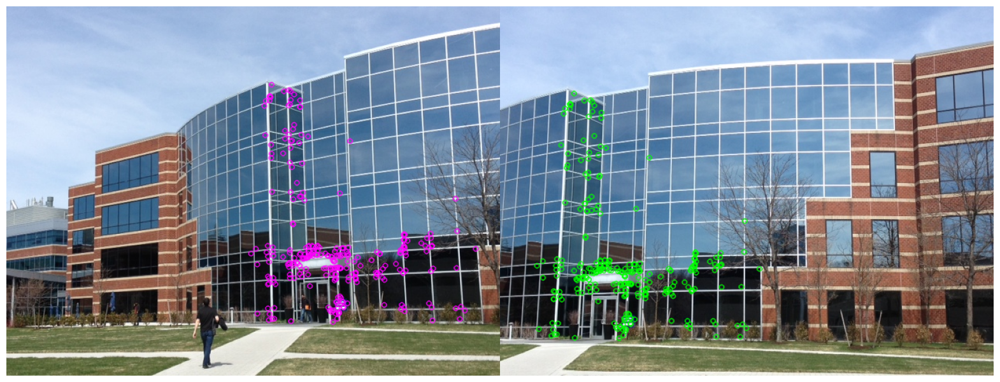

In [9]:
good = []
for m, n in matches:
    if m.distance < 0.6 * n.distance:
        good.append(m)

img1_kp = cv.drawKeypoints(img1, [keypoints1[m.queryIdx] for m in good], None, (255, 0, 255))
img2_kp = cv.drawKeypoints(img2, [keypoints2[m.trainIdx] for m in good], None, (0, 255, 0))
concatenated_kp_image = np.concatenate((img1_kp, img2_kp), axis=1)



plt.figure(figsize=(20, 20))
plt.imshow(cv.cvtColor(concatenated_kp_image, cv.COLOR_BGR2RGB))
plt.axis('off')  
plt.show()


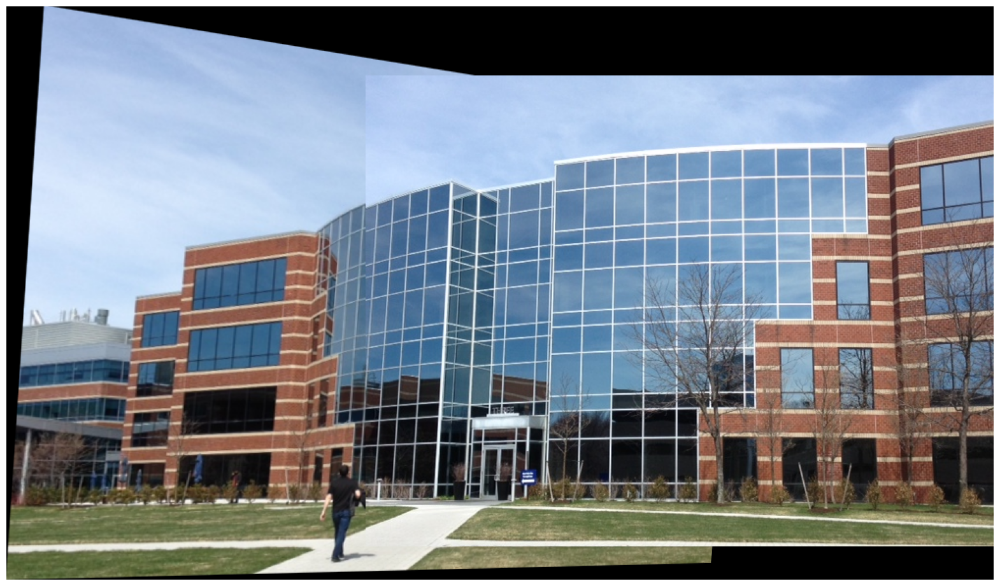

In [10]:
def warpImages(img1, img2, H):
  rows1, cols1 = img1.shape[:2]
  rows2, cols2 = img2.shape[:2]

  list_of_points_1 = np.float32([[0,0], [0, rows1],[cols1, rows1], [cols1, 0]]).reshape(-1, 1, 2)
  temp_points = np.float32([[0,0], [0,rows2], [cols2,rows2], [cols2,0]]).reshape(-1,1,2)

  # When we have established a homography we need to warp perspective
  # Change field of view
  list_of_points_2 = cv.perspectiveTransform(temp_points, H)

  list_of_points = np.concatenate((list_of_points_1, list_of_points_2), axis=0)

  [x_min, y_min] = np.int32(list_of_points.min(axis=0).ravel() - 0.5)
  [x_max, y_max] = np.int32(list_of_points.max(axis=0).ravel() + 0.5)

  translation_dist = [-x_min, -y_min]

  H_translation = np.array([[1, 0, translation_dist[0]], [0, 1, translation_dist[1]], [0, 0, 1]])

  output_img = cv.warpPerspective( img2, H_translation.dot(H), (x_max-x_min, y_max-y_min) )
  output_img[translation_dist[1]:rows1+translation_dist[1], translation_dist[0]:cols1+translation_dist[0]] = img1

  return output_img
  
MIN_MATCH_COUNT = 10 # Set minimum match condition

if len(good) > MIN_MATCH_COUNT:
    # Convert keypoints to an argument for findHomography
    src_pts = np.float32([ keypoints1[m.queryIdx].pt for m in good]).reshape(-1,1,2)
    dst_pts = np.float32([ keypoints2[m.trainIdx].pt for m in good]).reshape(-1,1,2)

    # Вычисление матрицы гомографии
    M, _ = cv.findHomography(src_pts, dst_pts, cv.RANSAC, 5.0)

    result = warpImages(img2, img1, M)

    plt.figure(figsize=(20, 20))
    plt.imshow(cv.cvtColor(result, cv.COLOR_BGR2RGB))
    plt.axis('off')  # 隐藏坐标轴
    plt.show()


In [11]:
img3 = cv.imread("building1/building3.jpg")

In [12]:
orb = cv.ORB_create(nfeatures=2000)

# Find the key points and descriptors with ORB
keypoints1, descriptors1 = orb.detectAndCompute(result, None)
keypoints2, descriptors2 = orb.detectAndCompute(img3, None)

img1_kp = cv.drawKeypoints(result, keypoints1, None, (255, 0, 255))
img2_kp = cv.drawKeypoints(img3, keypoints2, None, (0, 255, 0))



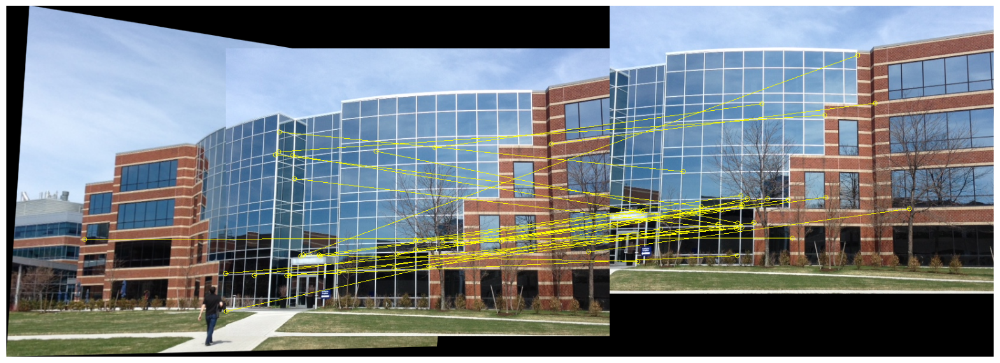

In [13]:
# Create a BFMatcher object.
# It will find all of the matching keypoints on two images
bf = cv.BFMatcher_create(cv.NORM_HAMMING)

# Find matching points
matches = bf.knnMatch(descriptors1, descriptors2, k=2)

all_matches = []
for m, n in matches:
  all_matches.append(m)

img4 = draw_matches(result, keypoints1, img3, keypoints2, all_matches[:30])
plt.figure(figsize=(20, 20))
plt.imshow(cv.cvtColor(img4, cv.COLOR_BGR2RGB))
plt.axis('off')  
plt.show()

In [14]:
good = []
for m, n in matches:
    if m.distance < 0.6 * n.distance:
        good.append(m)

result_kp = cv.drawKeypoints(result, [keypoints1[m.queryIdx] for m in good], None, (255, 0, 255))
img3_kp = cv.drawKeypoints(img3, [keypoints2[m.trainIdx] for m in good], None, (0, 255, 0))


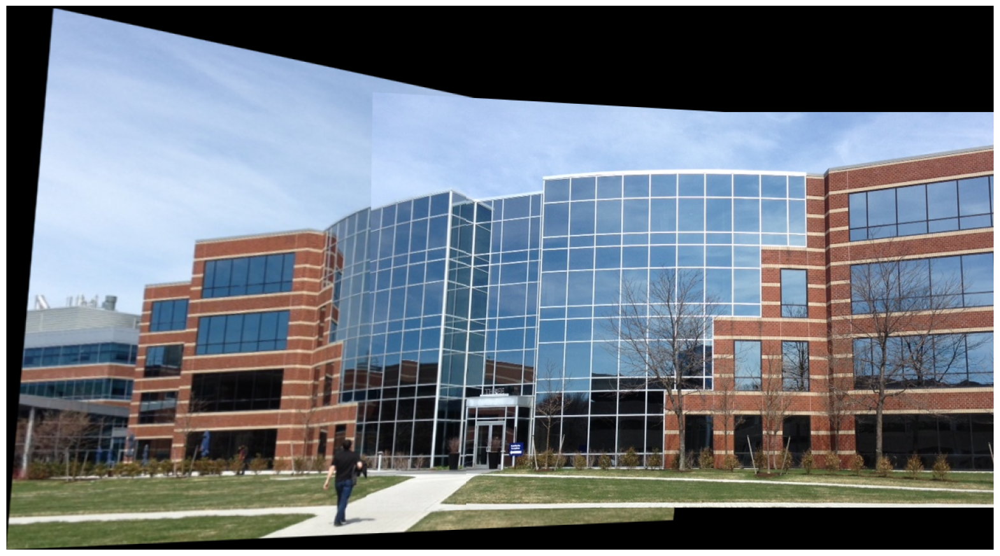

In [15]:
MIN_MATCH_COUNT = 10 # Set minimum match condition

if len(good) > MIN_MATCH_COUNT:
    # Convert keypoints to an argument for findHomography
    src_pts = np.float32([ keypoints1[m.queryIdx].pt for m in good]).reshape(-1,1,2)
    dst_pts = np.float32([ keypoints2[m.trainIdx].pt for m in good]).reshape(-1,1,2)

    # Вычисление матрицы гомографии
    M, _ = cv.findHomography(src_pts, dst_pts, cv.RANSAC, 5.0)

    result2 = warpImages(img3, result, M)

    plt.figure(figsize=(20, 20))
    plt.imshow(cv.cvtColor(result2, cv.COLOR_BGR2RGB))
    plt.axis('off') 
    plt.show()

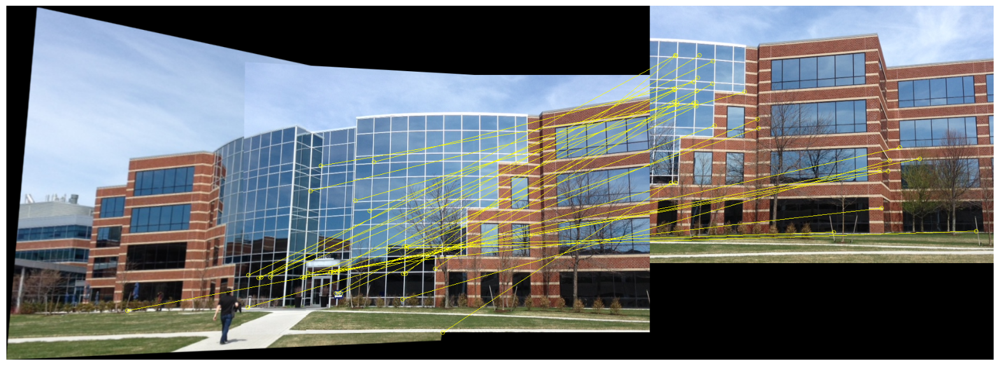

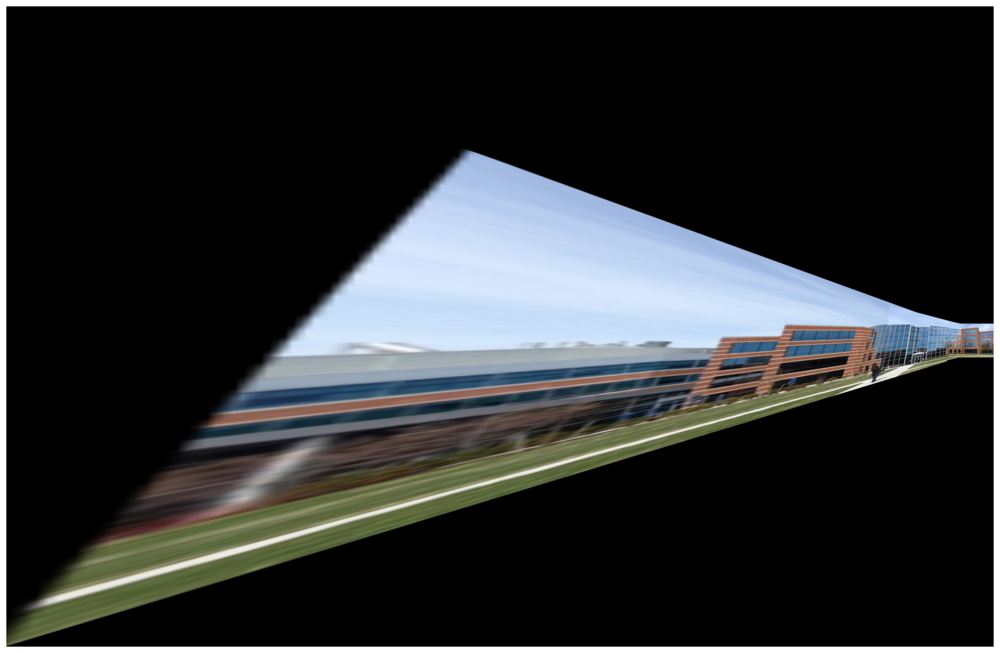

In [16]:
img4 = cv.imread("building1/building4.jpg")
orb = cv.ORB_create(nfeatures=2000)

# Find the key points and descriptors with ORB
keypoints1, descriptors1 = orb.detectAndCompute(result2, None)
keypoints2, descriptors2 = orb.detectAndCompute(img4, None)

img1_kp = cv.drawKeypoints(result2, keypoints1, None, (255, 0, 255))
img2_kp = cv.drawKeypoints(img4, keypoints2, None, (0, 255, 0))

# Create a BFMatcher object.
# It will find all of the matching keypoints on two images
bf = cv.BFMatcher_create(cv.NORM_HAMMING)

# Find matching points
matches = bf.knnMatch(descriptors1, descriptors2, k=2)

all_matches = []
for m, n in matches:
  all_matches.append(m)

img5 = draw_matches(result2, keypoints1, img4, keypoints2, all_matches[:30])
plt.figure(figsize=(20, 20))
plt.imshow(cv.cvtColor(img5, cv.COLOR_BGR2RGB))
plt.axis('off') 

good = []
for m, n in matches:
    if m.distance < 0.6 * n.distance:
        good.append(m)

result2_kp = cv.drawKeypoints(result2, [keypoints1[m.queryIdx] for m in good], None, (255, 0, 255))
img4_kp = cv.drawKeypoints(img4, [keypoints2[m.trainIdx] for m in good], None, (0, 255, 0))

MIN_MATCH_COUNT = 10 # Set minimum match condition

if len(good) > MIN_MATCH_COUNT:
    # Convert keypoints to an argument for findHomography
    src_pts = np.float32([ keypoints1[m.queryIdx].pt for m in good]).reshape(-1,1,2)
    dst_pts = np.float32([ keypoints2[m.trainIdx].pt for m in good]).reshape(-1,1,2)

    # Вычисление матрицы гомографии
    M, _ = cv.findHomography(src_pts, dst_pts, cv.RANSAC, 5.0)

    result3 = warpImages(img4, result2, M)

    plt.figure(figsize=(20, 20))
    plt.imshow(cv.cvtColor(result3, cv.COLOR_BGR2RGB))
    plt.axis('off')  
    plt.show()

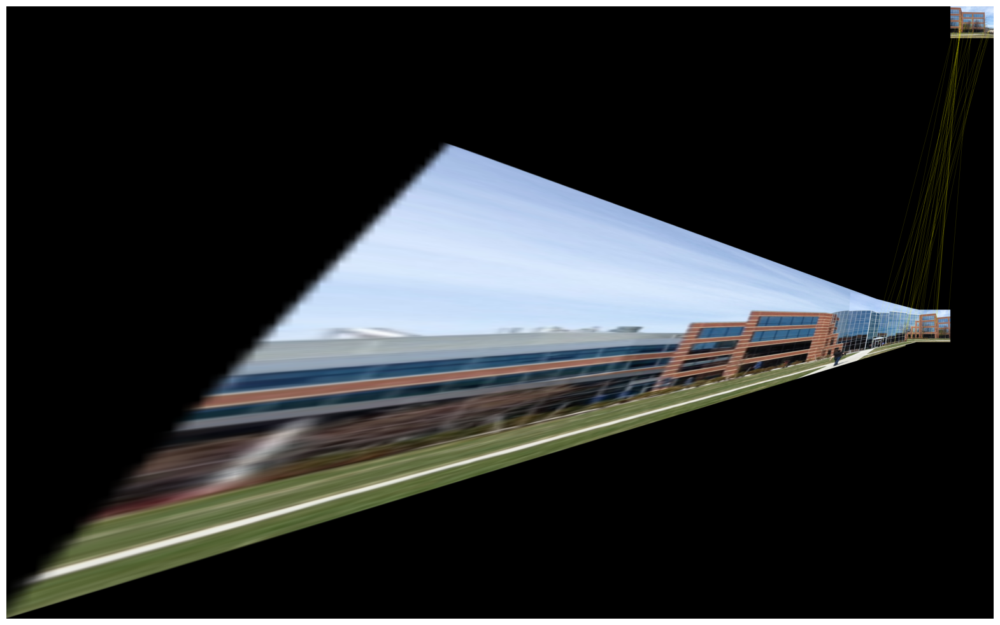

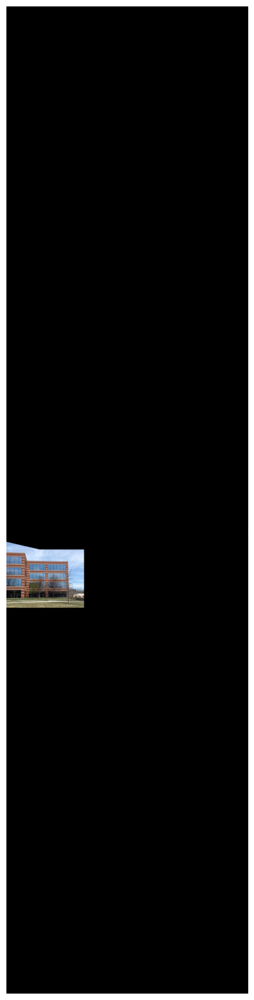

In [17]:
img5 = cv.imread("building1/building5.jpg")
orb = cv.ORB_create(nfeatures=2000)

# Find the key points and descriptors with ORB
keypoints1, descriptors1 = orb.detectAndCompute(result3, None)
keypoints2, descriptors2 = orb.detectAndCompute(img5, None)

img1_kp = cv.drawKeypoints(result3, keypoints1, None, (255, 0, 255))
img2_kp = cv.drawKeypoints(img5, keypoints2, None, (0, 255, 0))

# Create a BFMatcher object.
# It will find all of the matching keypoints on two images
bf = cv.BFMatcher_create(cv.NORM_HAMMING)

# Find matching points
matches = bf.knnMatch(descriptors1, descriptors2, k=2)

all_matches = []
for m, n in matches:
  all_matches.append(m)

img6 = draw_matches(result3, keypoints1, img5, keypoints2, all_matches[:30])
plt.figure(figsize=(20, 20))
plt.imshow(cv.cvtColor(img6, cv.COLOR_BGR2RGB))
plt.axis('off')  
plt.show()

good = []
for m, n in matches:
    if m.distance < 0.6 * n.distance:
        good.append(m)

result3_kp = cv.drawKeypoints(result3, [keypoints1[m.queryIdx] for m in good], None, (255, 0, 255))
img5_kp = cv.drawKeypoints(img5, [keypoints2[m.trainIdx] for m in good], None, (0, 255, 0))

MIN_MATCH_COUNT = 10 # Set minimum match condition

if len(good) > MIN_MATCH_COUNT:
    # Convert keypoints to an argument for findHomography
    src_pts = np.float32([ keypoints1[m.queryIdx].pt for m in good]).reshape(-1,1,2)
    dst_pts = np.float32([ keypoints2[m.trainIdx].pt for m in good]).reshape(-1,1,2)

    # Вычисление матрицы гомографии
    M, _ = cv.findHomography(src_pts, dst_pts, cv.RANSAC, 5.0)

    result4 = warpImages(img5, result3, M)

    plt.figure(figsize=(20, 20))
    plt.imshow(cv.cvtColor(result4, cv.COLOR_BGR2RGB))
    plt.axis('off')  
    plt.show()

# Algorithm 2

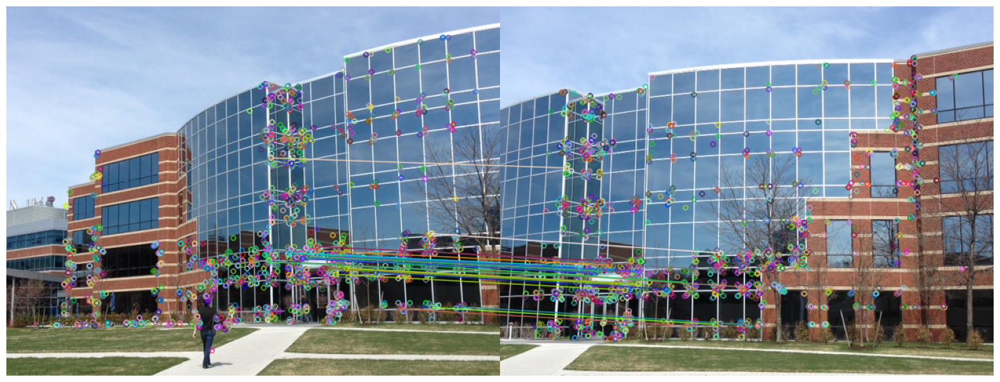

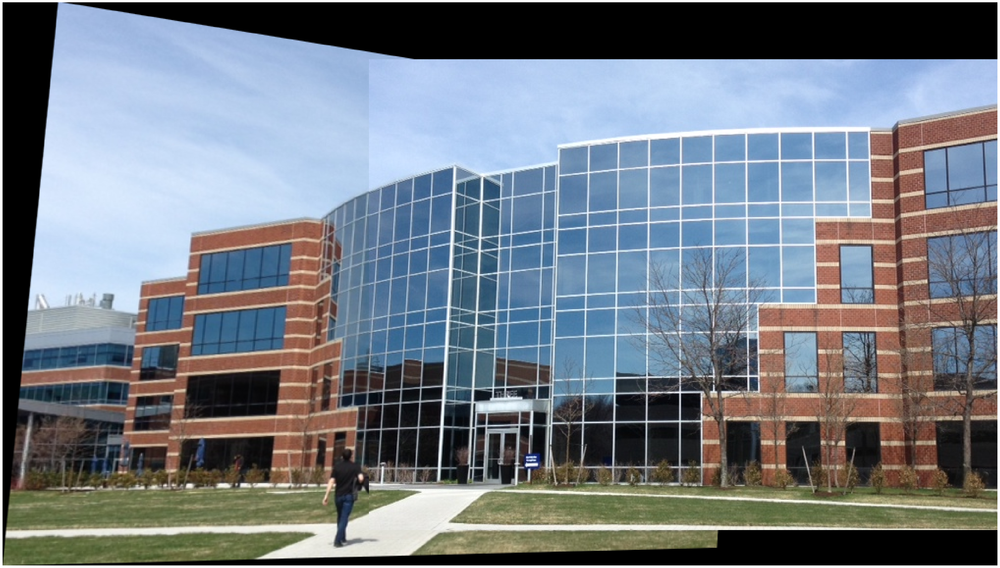

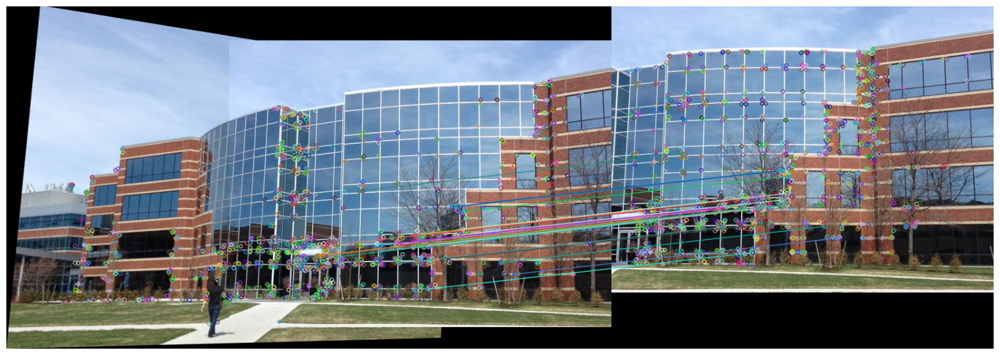

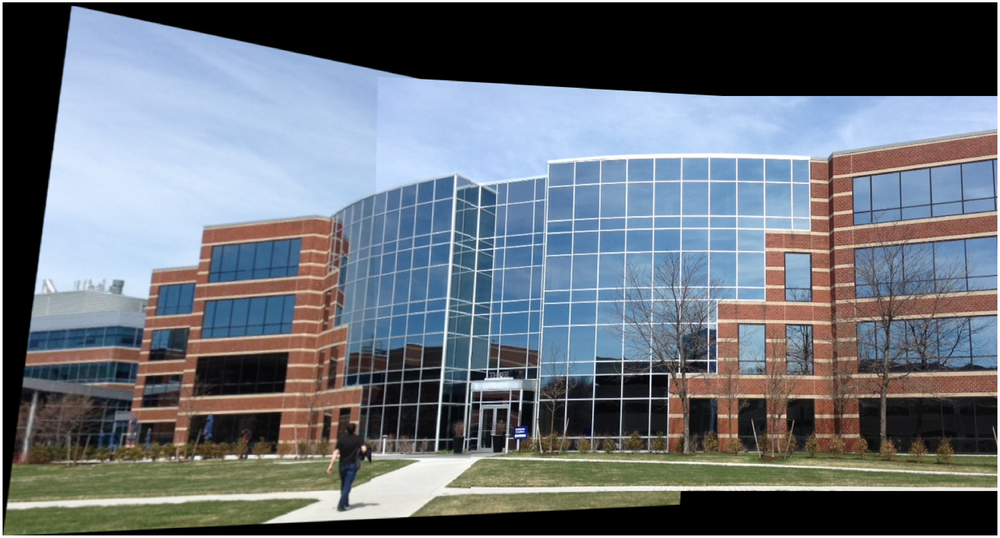

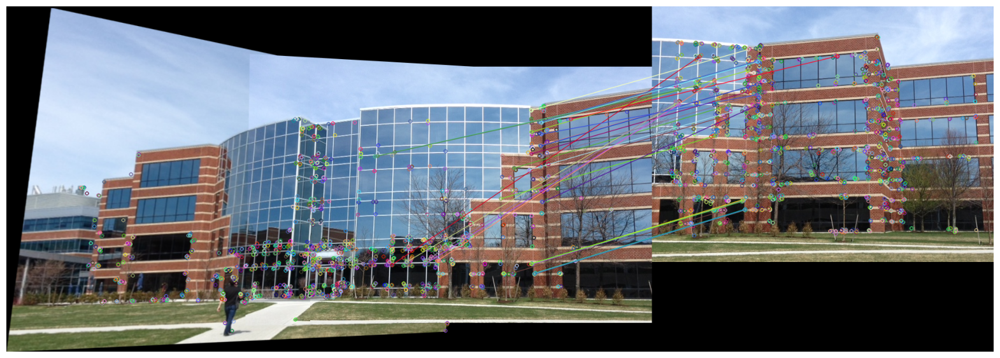

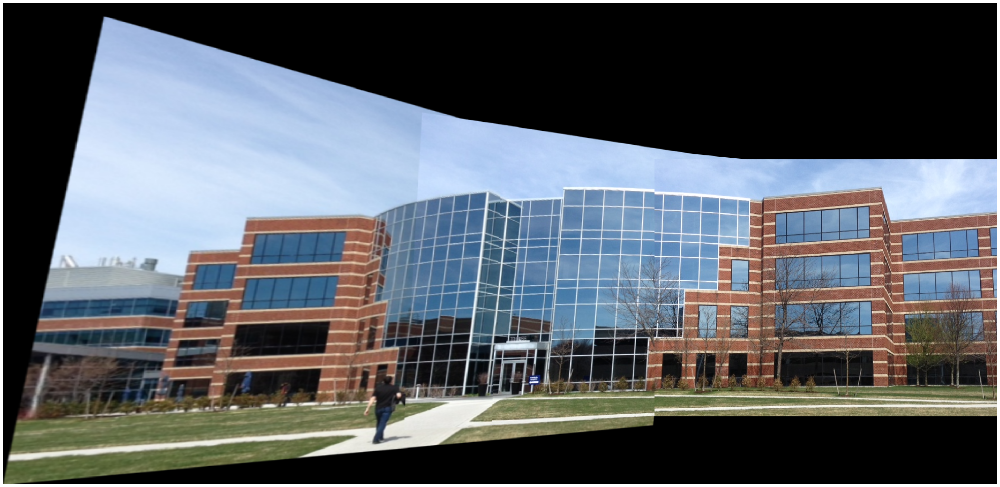

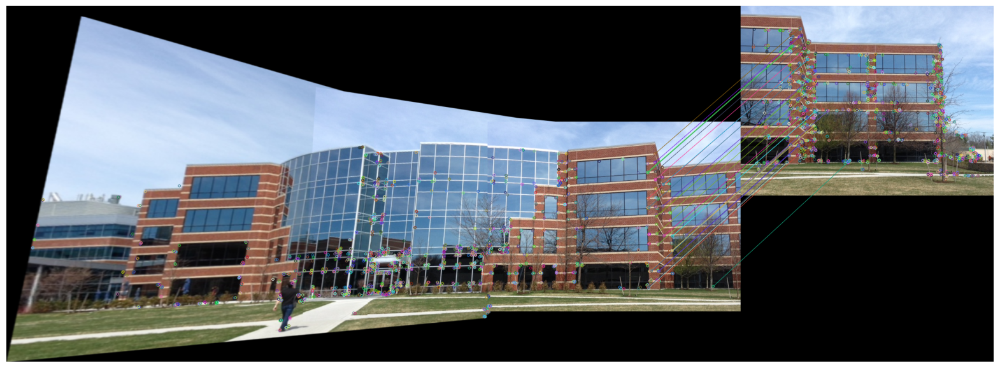

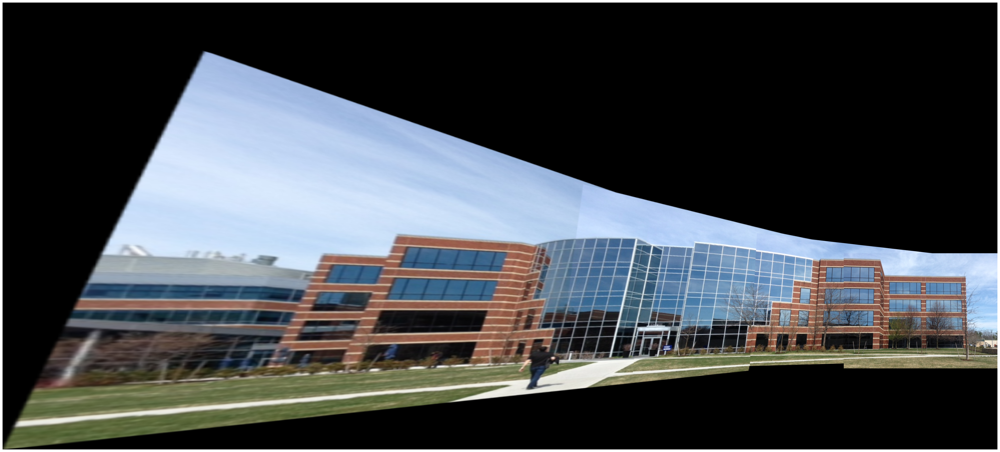

True

In [18]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def warpImages(img1, img2, H):
    rows1, cols1 = img1.shape[:2]
    rows2, cols2 = img2.shape[:2]

    list_of_points_1 = np.float32([[0, 0], [0, rows1], [cols1, rows1], [cols1, 0]]).reshape(-1, 1, 2)
    temp_points = np.float32([[0, 0], [0, rows2], [cols2, rows2], [cols2, 0]]).reshape(-1, 1, 2)

    list_of_points_2 = cv2.perspectiveTransform(temp_points, H)

    list_of_points = np.concatenate((list_of_points_1, list_of_points_2), axis=0)

    [x_min, y_min] = np.int32(list_of_points.min(axis=0).ravel() - 0.5)
    [x_max, y_max] = np.int32(list_of_points.max(axis=0).ravel() + 0.5)

    translation_dist = [-x_min, -y_min]

    H_translation = np.array([[1, 0, translation_dist[0]], [0, 1, translation_dist[1]], [0, 0, 1]])

    output_img = cv2.warpPerspective(img2, H_translation.dot(H), (x_max - x_min, y_max - y_min))
    output_img[translation_dist[1]:rows1 + translation_dist[1], translation_dist[0]:cols1 + translation_dist[0]] = img1

    return output_img

# Read all images
images = [cv2.imread("building1/building1.jpg"), cv2.imread("building1/building2.jpg"), cv2.imread("building1/building3.jpg"), cv2.imread("building1/building4.jpg"), cv2.imread("building1/building5.jpg")]

# Initialize the panorama as the first image
panorama1 = images[0]

# Iterate through the rest of the images
for i in range(1, len(images)):
    # Use ORB feature detector to find keypoints and descriptors
    orb = cv2.ORB_create(nfeatures=2000)
    kp1, des1 = orb.detectAndCompute(panorama1, None)
    kp2, des2 = orb.detectAndCompute(images[i], None)

    # Create a BFMatcher object
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

    # Match descriptors
    matches = bf.match(des1, des2)

    # Sort them in ascending order of distance
    matches = sorted(matches, key=lambda x: x.distance)

    # Draw the first 30 matches
    img3 = cv2.drawMatches(panorama1, kp1, images[i], kp2, matches[:30], outImg=None)
    plt.figure(figsize=(20, 20))
    plt.imshow(cv2.cvtColor(img3, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

    # Define a minimum number of good matches required for successful stitching
    MIN_MATCH_COUNT = 10

    if len(matches) > MIN_MATCH_COUNT:
        src_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
        dst_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

        # Calculate the homography matrix using RANSAC
        M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

        # Warp the current image to the panorama
        result = warpImages(images[i], panorama1, M)

        # Show the result
        plt.figure(figsize=(50, 50))
        plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()

        # Update the panorama and accumulated transform
        panorama1 = result

cv2.imwrite("panorama1.jpg", panorama1)
